# SDSS-2017 Dataset Full EDA and Classification Models

### Goal:
#### To perform a complete EDA [Exploratory Data Analysis] on the Solan Digital Sky Survey 2017 dataset and to create ML models to classify the various classes within this dataset with algorithms like KNN, SVM, Random Forest, etc.,

## Importing Basic Libraries

In [256]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

## Reading the CSV file (Dataset) using pandas

In [257]:
df= pd.read_csv("star_classification.csv")

## Checking dataset contents

In [258]:
df.head(5)

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,GALAXY,0.634794,5812,56354,171
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,GALAXY,0.779136,10445,58158,427
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,GALAXY,0.644195,4576,55592,299
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,301,3,214,1.030107e+19,GALAXY,0.932346,9149,58039,775
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,301,3,137,6.891865e+18,GALAXY,0.116123,6121,56187,842


In [259]:
df.columns

Index(['obj_ID', 'alpha', 'delta', 'u', 'g', 'r', 'i', 'z', 'run_ID',
       'rerun_ID', 'cam_col', 'field_ID', 'spec_obj_ID', 'class', 'redshift',
       'plate', 'MJD', 'fiber_ID'],
      dtype='object')

In [260]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 18 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   obj_ID       100000 non-null  float64
 1   alpha        100000 non-null  float64
 2   delta        100000 non-null  float64
 3   u            100000 non-null  float64
 4   g            100000 non-null  float64
 5   r            100000 non-null  float64
 6   i            100000 non-null  float64
 7   z            100000 non-null  float64
 8   run_ID       100000 non-null  int64  
 9   rerun_ID     100000 non-null  int64  
 10  cam_col      100000 non-null  int64  
 11  field_ID     100000 non-null  int64  
 12  spec_obj_ID  100000 non-null  float64
 13  class        100000 non-null  object 
 14  redshift     100000 non-null  float64
 15  plate        100000 non-null  int64  
 16  MJD          100000 non-null  int64  
 17  fiber_ID     100000 non-null  int64  
dtypes: float64(10), int64(7),

## Checking the categories of stellar objects

In [261]:
df['class'].unique()

array(['GALAXY', 'QSO', 'STAR'], dtype=object)

## Encoding the categorical strings into integer values

In [262]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df["class"] = le.fit_transform(df["class"])
df["class"] = df["class"].astype(int)

In [263]:
df['class'].unique()

array([0, 1, 2])

In [264]:
g = df["g"].sort_values(ascending = False)
r = df['r'].sort_values(ascending = False)
i = df['i'].sort_values(ascending = False)
u = df['u'].sort_values(ascending = False)
z = df['z'].sort_values(ascending = False)

## Checking for correlation against different column combinations

In [265]:
df.corr()

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
obj_ID,1.000000,-0.013735,-0.301237,0.015310,0.015710,0.153891,0.147670,0.013811,1.000000,NaN,-0.046997,0.031498,0.239461,-0.036012,0.065400,0.239460,0.262687,0.067178
alpha,-0.013735,1.000000,0.138691,-0.001532,-0.002423,-0.022083,-0.023580,-0.002918,-0.013737,NaN,0.019582,-0.165577,-0.002553,-0.011756,0.001667,-0.002554,0.019943,0.030464
delta,-0.301237,0.138691,1.000000,0.002074,0.003523,-0.006835,-0.004480,0.003630,-0.301238,NaN,0.032565,-0.173416,0.112329,0.014452,0.031638,0.112329,0.107333,0.028250
u,0.015310,-0.001532,0.002074,1.000000,0.999311,0.054149,0.045730,0.998093,0.015309,NaN,0.003548,-0.008374,0.029997,-0.024645,0.014309,0.029997,0.031997,0.016305
g,0.015710,-0.002423,0.003523,0.999311,1.000000,0.062387,0.056271,0.999161,0.015710,NaN,0.003508,-0.008852,0.039443,-0.020066,0.022954,0.039443,0.040274,0.017470
r,0.153891,-0.022083,-0.006835,0.054149,0.062387,1.000000,0.962868,0.053677,0.153889,NaN,0.008480,-0.026423,0.655245,-0.076766,0.433241,0.655243,0.671180,0.223106
i,0.147670,-0.023580,-0.004480,0.045730,0.056271,0.962868,1.000000,0.055994,0.147668,NaN,0.007615,-0.026679,0.661641,0.015028,0.492383,0.661640,0.672523,0.214787
z,0.013811,-0.002918,0.003630,0.998093,0.999161,0.053677,0.055994,1.000000,0.013811,NaN,0.003365,-0.008903,0.037813,-0.001614,0.030380,0.037813,0.037469,0.014668
run_ID,1.000000,-0.013737,-0.301238,0.015309,0.015710,0.153889,0.147668,0.013811,1.000000,NaN,-0.047098,0.031498,0.239460,-0.036014,0.065400,0.239459,0.262687,0.067165
rerun_ID,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# EDA

## Importing plotly classes for data representation

In [266]:
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

## Comparing the value distribution of 5 different filters

In [267]:
fig = make_subplots(rows=5, cols=1)
tr1=go.Histogram(x=r,name='Red filter value Histogram')
fig.add_trace(tr1,row=1,col=1)
fig.update_layout(height=700, width=700, title_text="Distribution of Various Spectrum Bands")
tr2 = go.Histogram(x=g,name = 'Green filter value Histogram')
fig.add_trace(tr2,row = 2, col = 1)
tr3 = go.Histogram(x=i,name = 'Near Infrared filter value Histogram')
fig.add_trace(tr3,row = 3,col = 1)
tr4 = go.Histogram(x=z,name = 'Mid Infrared filter value Histogram')
fig.add_trace(tr4,row = 4,col = 1)
tr5 = go.Histogram(x=u,name = 'Ultraviolet filter value Histogram')
fig.add_trace(tr5,row = 5,col = 1)
fig.show()

## Something is wrong with these histograms

#### If you take a look at the histograms, the UV, Infrared and Green filter distribution is not as even as the red and Near IR. I'm speculating it happens due to the presence of a really high value (-ve) which doesnt belong to actual readings.. This might be due to the "-9999.0" values which is a popular value used instead of None/NaN values. Let's see if thats the case

In [268]:
print(-9999.0 in df['u'].values)
print(-9999.0 in df['g'].values)
print(-9999.0 in df['i'].values)
print(-9999.0 in df['z'].values)
print(-9999.0 in df['r'].values)

True
True
False
True
False


#### As suspected, its the -9999.0 which is causing the histograms to look weird.. We can resolve it by removing if its negligible

In [269]:
print(df.loc[df['u'] == -9999.0])

             obj_ID       alpha     delta       u       g        r         i  \
79543  1.237649e+18  224.006526 -0.624304 -9999.0 -9999.0  18.1656  18.01675   

            z  run_ID  rerun_ID  cam_col  field_ID   spec_obj_ID  class  \
79543 -9999.0     752       301        2       537  3.731277e+18      2   

       redshift  plate    MJD  fiber_ID  
79543  0.000089   3314  54970       162  


In [270]:
df.drop(df.index[df['u'] == -9999.0],axis = 0,inplace = True)

In [271]:
print(-9999.0 in df['u'].values)
print(-9999.0 in df['g'].values)
print(-9999.0 in df['i'].values)
print(-9999.0 in df['z'].values)
print(-9999.0 in df['r'].values)

g = df["g"].sort_values(ascending = False)
r = df['r'].sort_values(ascending = False)
i = df['i'].sort_values(ascending = False)
u = df['u'].sort_values(ascending = False)
z = df['z'].sort_values(ascending = False)

False
False
False
False
False


#### Now let's run the histogram once again

## Comparing the value distribution of 5 different filters

In [272]:
fig = make_subplots(rows=5, cols=1)
fig.update_layout(height=700, width=700, title_text="Distribution of Various Spectrum Bands")
tr1=go.Histogram(x=r,name='Red filter value Histogram')
fig.add_trace(tr1,row=1,col=1)
tr2 = go.Histogram(x=g,name = 'Green filter value Histogram')
fig.add_trace(tr2,row = 2, col = 1)
tr3 = go.Histogram(x=i,name = 'Near Infrared filter value Histogram')
fig.add_trace(tr3,row = 3,col = 1)
tr4 = go.Histogram(x=z,name = 'Mid Infrared filter value Histogram')
fig.add_trace(tr4,row = 4,col = 1)
tr5 = go.Histogram(x=u,name = 'Ultraviolet filter value Histogram')
fig.add_trace(tr5,row = 5,col = 1)
fig.show()

## Redshift Distribution

In [273]:
#df['redshift']
fig = make_subplots(rows=1, cols=1)
fig.update_layout(height=500, width=500,title_text="Redshift value distribution for various stellar objects")
h1=go.Histogram(x=df['redshift'],name='Redshift')
fig.add_trace(h1,row=1,col=1)
fig.update_traces(marker_color='red')
fig.show()

## Number of galaxies,quasars and stars in the dataset

In [274]:
print(list(df['class'].value_counts()))

[59445, 21593, 18961]


## Distribution of different stellar objects 

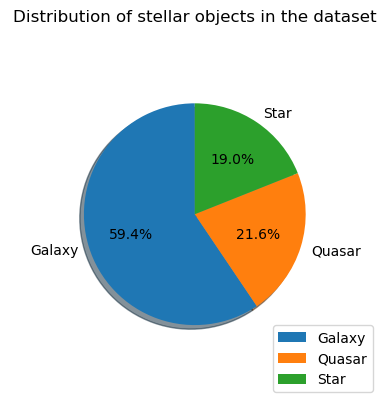

In [275]:
t =['Galaxy','Quasar','Star']
mylabels = list(t)
plt.pie(list(df['class'].value_counts()),shadow = True, startangle = 90,labels = mylabels,autopct='%1.1f%%',radius = 0.75)
plt.legend()
plt.title("Distribution of stellar objects in the dataset")
plt.show()

## Checking the distribution Redshift of different stellar objects individually

In [276]:
galaxy = df[df['class']==0]['redshift'].values
quasar = df[df['class']==1]['redshift'].values
star = df[df['class']==2]['redshift'].values

In [277]:
print(len(star))
print(len(galaxy))
print(len(quasar))

21593
59445
18961


## Visual Representation of Redshift distribution accross different objects

In [278]:
fig = make_subplots(rows=3, cols=1)
fig.update_layout(height=700, width=700, title_text="Redshift value distribution for each class")
gx=go.Histogram(x=galaxy,name='Galaxy Redshift')
fig.add_trace(gx,row=1,col=1)
qs=go.Histogram(x=quasar,name='Quasar Redshift')
fig.add_trace(qs,row=2,col=1)
st=go.Histogram(x=star,name='Star Redshift')
fig.add_trace(st,row=3,col=1)
fig.show()

### Redshift is crucial to identify the stellar object so we will be keep this column regardless

# Data representation using sns kdeplot method

In [297]:
#To plot a graph
def plot(column):
    for i in range(3):
        sns.kdeplot(data=df[df["class"] == i][column], label = le.inverse_transform([i]))
    plt.legend();
    
#Standardized plot to remove extreme ends and have smoother curve
def standard_plot(column):
    for i in range(3):
        sns.kdeplot(data=np.log(df[df["class"] == i][column]), label = le.inverse_transform([i]))
    plt.legend();

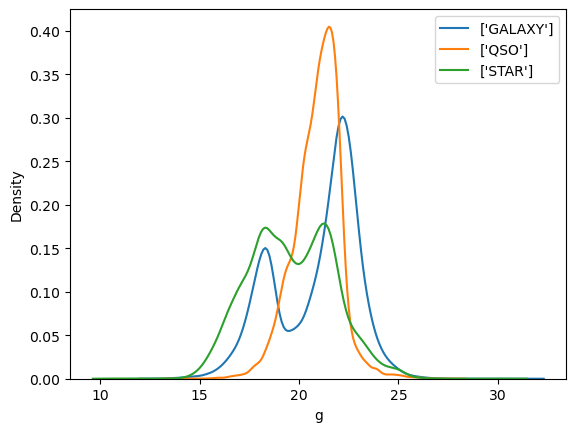

In [298]:
plot('g')

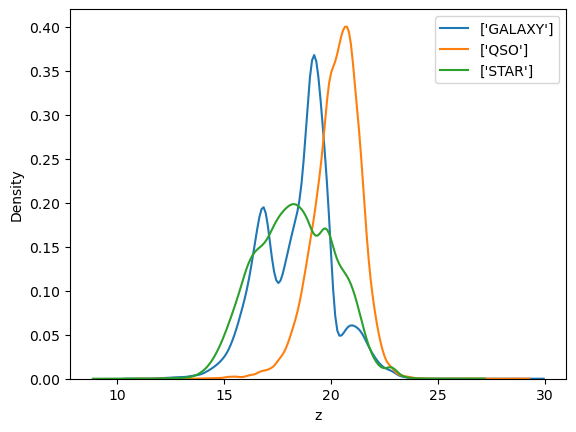

In [299]:
plot('z')

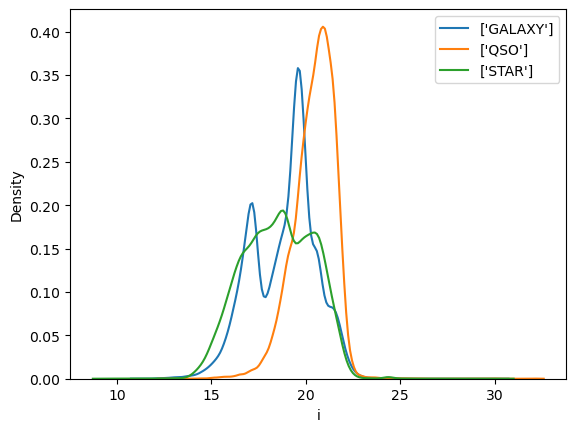

In [300]:
plot('i')

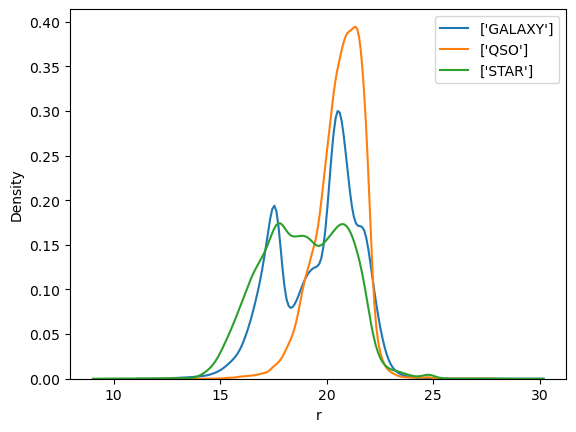

In [301]:
plot('r')

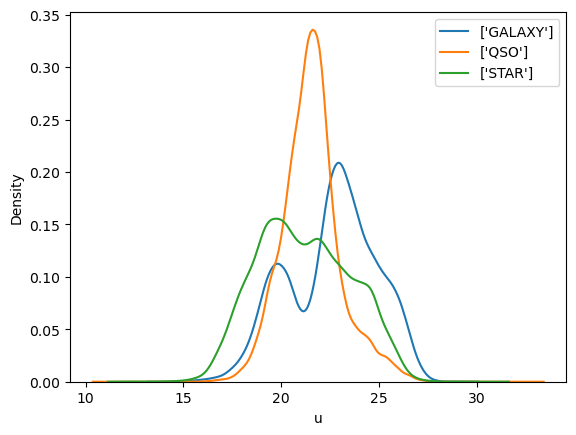

In [302]:
plot('u')

###### Filter values such as g,u,i,z and r are distributed with distinct ranges between different categories
###### so these colums will be retained for the model

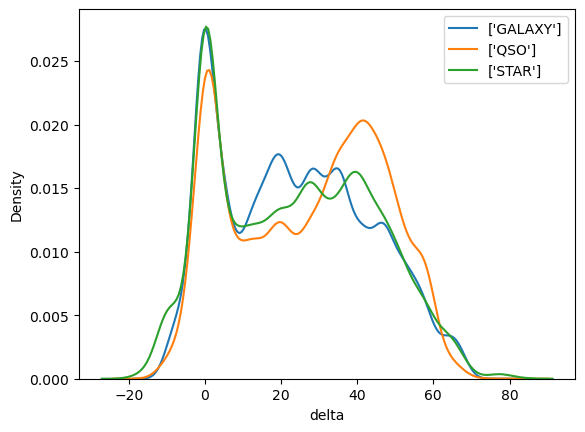

In [303]:
plot('delta')

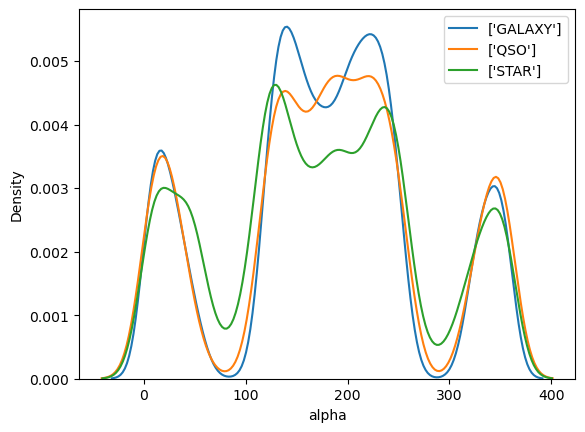

In [304]:
plot('alpha')

###### delta and alpha values doesnt show much distinct range but the distribution of values across each stellar object has
###### some variance hence I will include these into the model


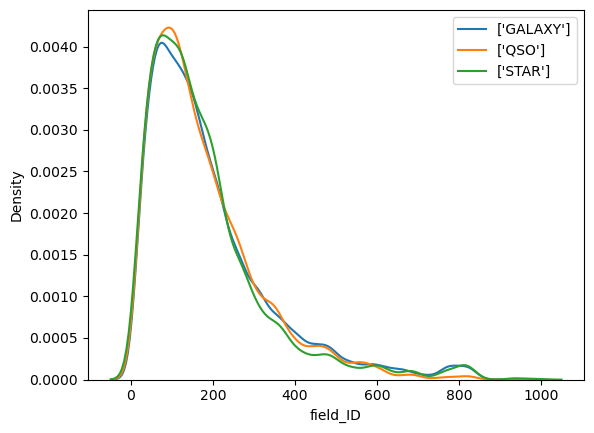

In [305]:
plot('field_ID')

###### Field ID has no correlation with the features of a stellar object and shows less distinction hence it will be neglected

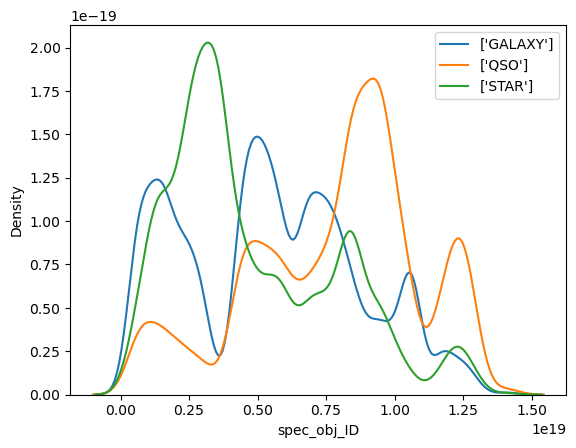

In [306]:
plot('spec_obj_ID')

###### spec_obj_ID is an ID value given to entries which represent the same object but different observations.
###### These IDs might create a bias in the outcome therefore i will be removing this column

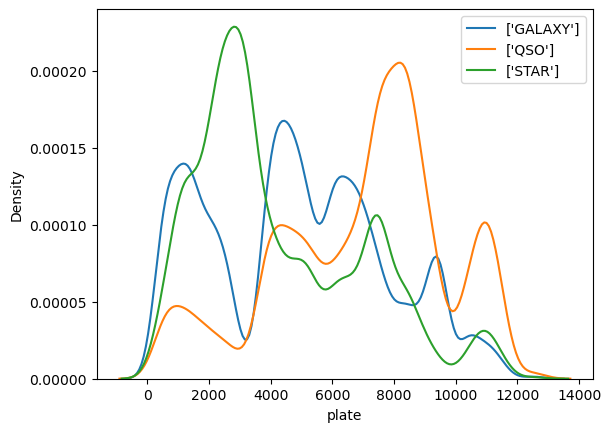

In [309]:
plot('plate')

###### Plates AKA Plug Plates are instruments made of aluminium with 1000's of holes in them
###### These plates are used to capture the light of different stellar objects and helps the telescopes to focus specifically
###### There are more than 10,000 plates in existence and these plates are used to observe certain stellar objects
###### I will retain the column since it shows distinction and has robust distribution

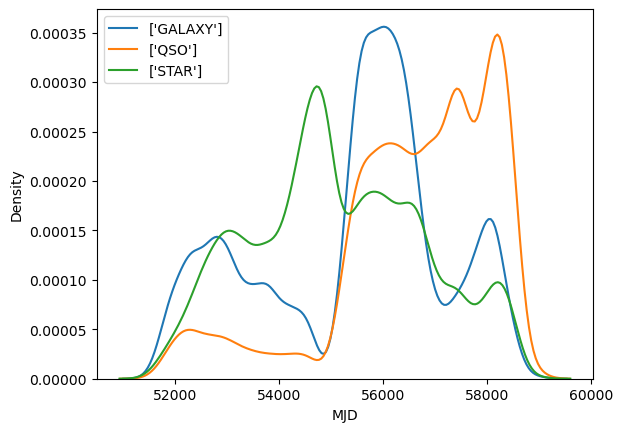

In [310]:
plot('MJD')

###### The Julian day is the continuous count of days since the beginning of the Julian period,
###### and is used primarily by astronomers, and in software for easily calculating elapsed days between two events.
###### Basically a different format to represent the date when the observations were made
###### This might not contribute to our classification
###### Therefore I will be removing it

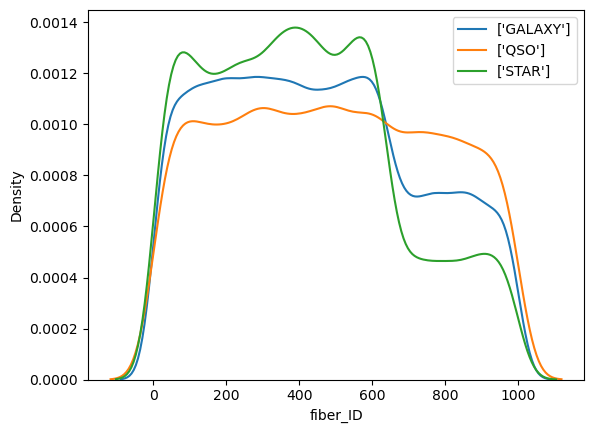

In [311]:
plot('fiber_ID')

###### an integer denoting the fiber number (1 to 640 for SDSS-I/II; 1 to 1000 for BOSS)
###### fiber ID that identifies the fiber that pointed the light at the focal plane in each observation
###### Fiber ID can influence the values observed [different fiber count produces different values]
###### So this can stay

###### I will also remove the run_ID, re_run_ID and cam_col columns to keep it simple for now 

## Heatmap

<AxesSubplot:>

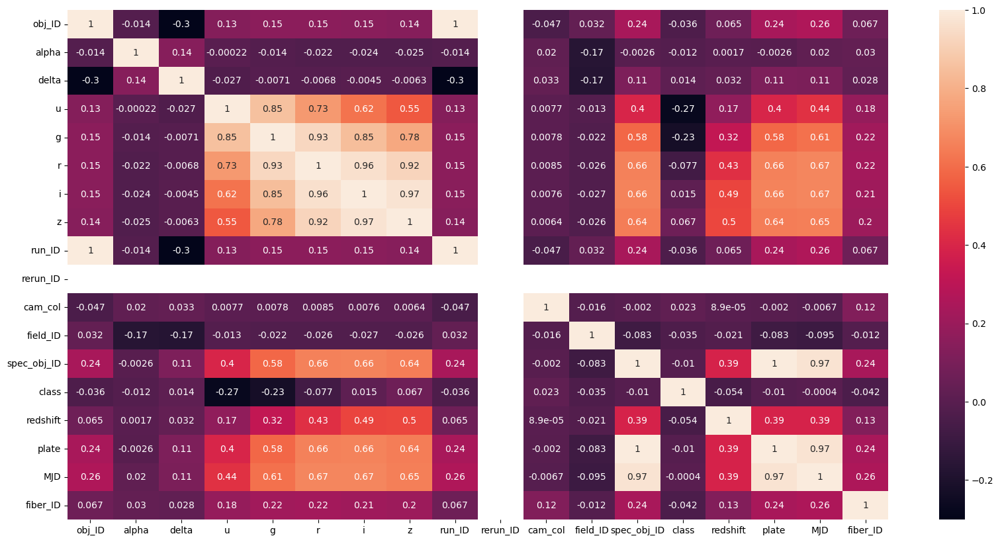

In [312]:
plt.figure(figsize=(20,10))
sns.heatmap(df.corr(),annot=True)

# Classifications

## In this attempt, I will try to classify stellar objects based on variables like redshift, filter values,plate value etc.,

## I will be training and testing ML models using the following algorithms

### 1. K Nearest Neighbors
### 2. Support Vector Machine
### 3. Naive Bayes
### 4. Decision Tree
### 5. Random Forest
### 6. Gradient Boosting Algorithm

### And i will compare all these different models and pick the best model with the highest accuracy

## Importing necessary ML libraries

In [201]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score

# Preprocessing the data

In [313]:
df = df.drop(['obj_ID','run_ID','rerun_ID','cam_col','MJD','spec_obj_ID','field_ID','fiber_ID'], axis = 1)

In [314]:
df.columns

Index(['alpha', 'delta', 'u', 'g', 'r', 'i', 'z', 'class', 'redshift',
       'plate'],
      dtype='object')

## Splitting the dataset

In [315]:
x = df.drop(['class'], axis = 1)
y = df.loc[:,'class'].values

## Feature scaling using MinMaxScaler

In [316]:
mms = MinMaxScaler()
x = mms.fit_transform(x)

## Test train split

In [317]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.33, random_state = 42,shuffle = True)

# KNN (K Nearest Neighbors)

In [318]:
KNN_classifier = KNeighborsClassifier(n_neighbors = 5,metric = 'minkowski',p = 2)

In [319]:
KNN_classifier.fit(x_train,y_train)

KNeighborsClassifier()

In [320]:
x_test[0]
test_val = mms.inverse_transform(x_test)
print(test_val[0])
print(y_test[0])

[1.18663236e+02 3.96424292e+01 2.28577300e+01 2.21887400e+01
 2.13556200e+01 2.12657700e+01 2.09393500e+01 1.17428900e+00
 9.35700000e+03]
1


In [321]:
print(KNN_classifier.predict(mms.transform([[2.28577300e+01, 2.21887400e+01, 2.13556200e+01, 2.12657700e+01,
       2.09393500e+01, 1.05352201e+19, 1.17428900e+00, 9.35700000e+03,
       5.78070000e+04]])))

C:\Users\User\anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning:

X does not have valid feature names, but MinMaxScaler was fitted with feature names



[0]


## Confusion Matrix: KNN

In [322]:
from sklearn.metrics import plot_confusion_matrix

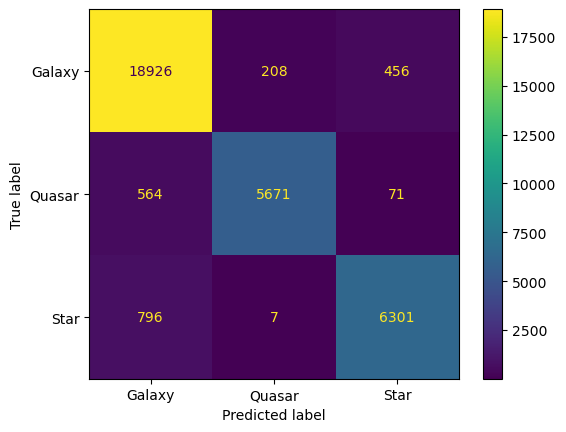

Accuracy score of KNN Classifier: 0.9363030303030303
              precision    recall  f1-score   support

           0       0.93      0.97      0.95     19590
           1       0.96      0.90      0.93      6306
           2       0.92      0.89      0.90      7104

    accuracy                           0.94     33000
   macro avg       0.94      0.92      0.93     33000
weighted avg       0.94      0.94      0.94     33000



In [323]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(KNN_classifier, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = KNN_classifier.predict(x_test)
acc_knn = accuracy_score(y_test, y_pred)
print("Accuracy score of KNN Classifier:",acc_knn)
print(classification_report(y_test,y_pred))

# SVC (Support Vector Classifier)

In [324]:
SV_classifier = SVC(kernel = 'rbf',random_state = 42)
SV_classifier.fit(x_train,y_train)

SVC(random_state=42)

In [325]:
print("Predicted value: ",SV_classifier.predict([x_test[0]]))
print("Actual value: ",y_test[0])

Predicted value:  [1]
Actual value:  1


## Confusion Matrix: SVC

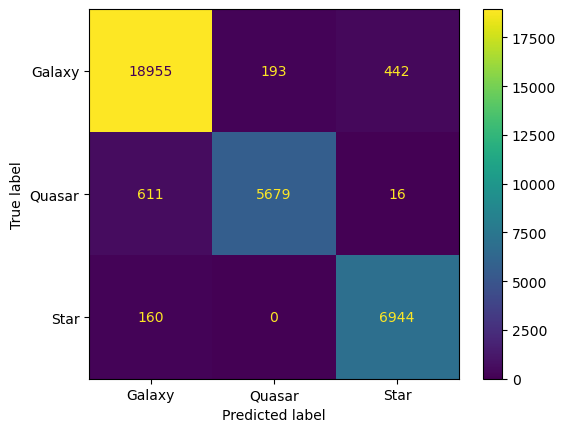

Accuracy score of SV Classifier: 0.9569090909090909
              precision    recall  f1-score   support

           0       0.96      0.97      0.96     19590
           1       0.97      0.90      0.93      6306
           2       0.94      0.98      0.96      7104

    accuracy                           0.96     33000
   macro avg       0.96      0.95      0.95     33000
weighted avg       0.96      0.96      0.96     33000



In [326]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(SV_classifier, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = SV_classifier.predict(x_test)
acc_svc = accuracy_score(y_test, y_pred)
print("Accuracy score of SV Classifier:",acc_svc)
print(classification_report(y_test,y_pred))

# Naive Bayes

In [327]:
from sklearn.naive_bayes import GaussianNB
nb = GaussianNB()
nb.fit(x_train,y_train)

GaussianNB()

In [328]:
print("Predicted value: ",nb.predict([x_test[0]]))
print("Actual value: ",y_test[0])

Predicted value:  [1]
Actual value:  1


## Confusion Matrix: Naive Bayes

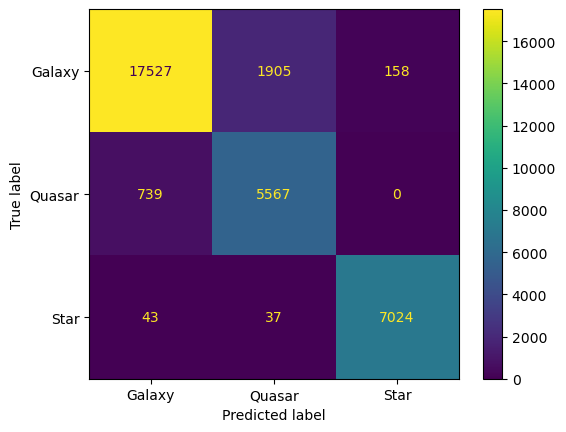

Accuracy score of SV Classifier: 0.9126666666666666
              precision    recall  f1-score   support

           0       0.96      0.89      0.92     19590
           1       0.74      0.88      0.81      6306
           2       0.98      0.99      0.98      7104

    accuracy                           0.91     33000
   macro avg       0.89      0.92      0.90     33000
weighted avg       0.92      0.91      0.91     33000



In [329]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(nb, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = nb.predict(x_test)
acc_gnb = accuracy_score(y_test, y_pred)
print("Accuracy score of SV Classifier:",acc_gnb)
print(classification_report(y_test,y_pred))

# Decision Tree Classification

In [330]:
Tree = DecisionTreeClassifier(criterion = 'entropy',random_state = 42)
Tree.fit(x_train,y_train)

DecisionTreeClassifier(criterion='entropy', random_state=42)

In [331]:
print("Predicted value: ",Tree.predict([x_test[0]]))
print("Actual value: ",y_test[0])

Predicted value:  [1]
Actual value:  1


## Confusion Matrix: Decision Tree

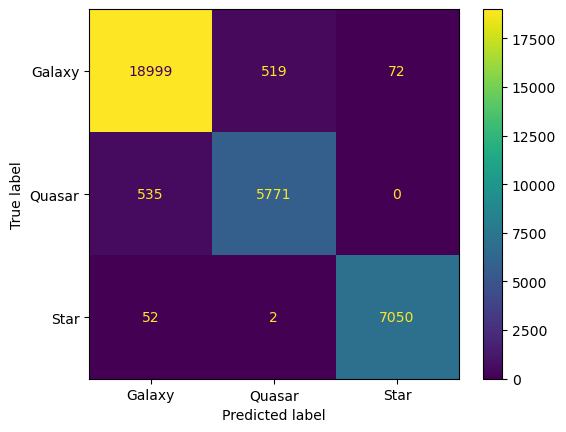

Accuracy score of Decision Tree Classifier: 0.9642424242424242
              precision    recall  f1-score   support

           0       0.97      0.97      0.97     19590
           1       0.92      0.92      0.92      6306
           2       0.99      0.99      0.99      7104

    accuracy                           0.96     33000
   macro avg       0.96      0.96      0.96     33000
weighted avg       0.96      0.96      0.96     33000



In [332]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(Tree, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = Tree.predict(x_test)
acc_tree = accuracy_score(y_test, y_pred)
print("Accuracy score of Decision Tree Classifier:",acc_tree)
print(classification_report(y_test,y_pred))

# Random Forest Classifier

In [333]:
Forest = RandomForestClassifier(n_estimators = 100, criterion = 'entropy',random_state = 42)
Forest.fit(x_train,y_train)

RandomForestClassifier(criterion='entropy', random_state=42)

In [334]:
print("Predicted value: ",Forest.predict([x_test[0]]))
print("Actual value: ",y_test[0])

Predicted value:  [1]
Actual value:  1


## Confusion Matrix: Random Forest

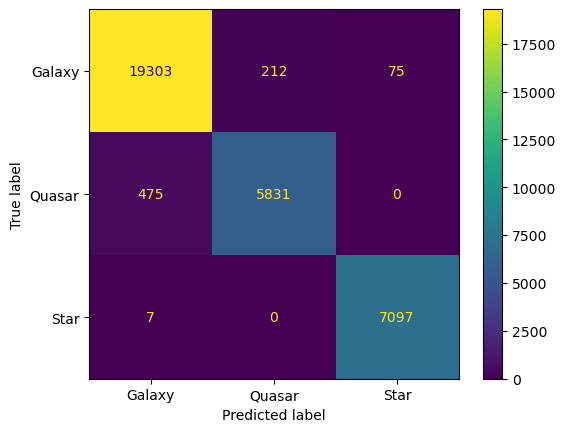

Accuracy score of Random Forest Classifier: 0.9766969696969697
              precision    recall  f1-score   support

           0       0.98      0.99      0.98     19590
           1       0.96      0.92      0.94      6306
           2       0.99      1.00      0.99      7104

    accuracy                           0.98     33000
   macro avg       0.98      0.97      0.97     33000
weighted avg       0.98      0.98      0.98     33000



In [335]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(Forest, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = Forest.predict(x_test)
acc_forest = accuracy_score(y_test, y_pred)
print("Accuracy score of Random Forest Classifier:",acc_forest)
print(classification_report(y_test,y_pred))

# Gradient Boosting Classifier

In [336]:
from sklearn.ensemble import GradientBoostingClassifier

In [337]:
gbc = GradientBoostingClassifier()
gbc.fit(x_train,y_train)

GradientBoostingClassifier()

In [338]:
print("Predicted value: ",gbc.predict([x_test[0]]))
print("Actual value: ",y_test[0])

Predicted value:  [1]
Actual value:  1


## Confusion Matrix: GBC

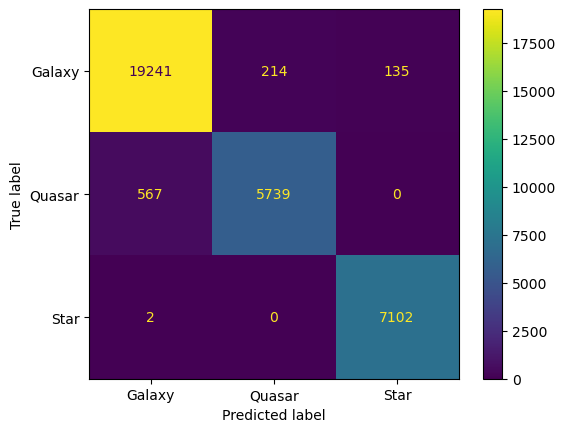

Accuracy score of Gradient Boosting Classifier: 0.9721818181818181
              precision    recall  f1-score   support

           0       0.97      0.98      0.98     19590
           1       0.96      0.91      0.94      6306
           2       0.98      1.00      0.99      7104

    accuracy                           0.97     33000
   macro avg       0.97      0.96      0.97     33000
weighted avg       0.97      0.97      0.97     33000



In [339]:
labels = ['Galaxy','Quasar','Star']
plot_confusion_matrix(gbc, x_test, y_test,display_labels = labels)  
plt.show()
y_pred = gbc.predict(x_test)
acc_gbc = accuracy_score(y_test, y_pred)
print("Accuracy score of Gradient Boosting Classifier:",acc_gbc)
print(classification_report(y_test,y_pred))

## Accuracy scores of all the models 

In [340]:
print("Accuracy Score of different models")
print("Naive Bayes (Guassian): ",acc_gnb)
print("K Nearest Neighbors: ",acc_knn)
print("Support Vector Classifier: ",acc_svc)
print("Decision Tree Classifier: ",acc_tree)
print("Random Forest Classifier (100 estimators): ",acc_forest)
print("Gradient Boosting Classifier: ",acc_gbc)

Accuracy Score of different models
Naive Bayes (Guassian):  0.9126666666666666
K Nearest Neighbors:  0.9363030303030303
Support Vector Classifier:  0.9569090909090909
Decision Tree Classifier:  0.9642424242424242
Random Forest Classifier (100 estimators):  0.9766969696969697
Gradient Boosting Classifier:  0.9721818181818181


## Random Forest performed best with an accuracy score of 0.976 on the test set

# Note: Hyper params are not fully utilized. Utilizing them can improve each model's performance and accuracy